# Explore SpeechBrain: Speaker Diarization

This notebook will explore speaker diarization using the Python library [SpeechBrain](https://speechbrain.github.io/index.html). It can be installed with `pip install speechbrain`. To run the notebook for the first time, it must be opened with administrator rights.

Speaker diarization refers to the task of predicting "who spoke when" in an audio file. The number of speakers is not necessarily known in advance and has to be determined during the task. Following Dawalatabad et al. (2021; https://arxiv.org/abs/2104.01466), the ECAPA-TDNN architecture will be used to generate speaker embeddings for audio signals. Using spectral clustering, these embeddings will then be used to assign a speaker id/label.

In [1]:
""" Explore speechbrain speaker diarization """
import matplotlib.pyplot as plt
import numpy as np
import torch
import torchaudio
from IPython.display import Audio, display
from speechbrain.pretrained import EncoderClassifier, VAD
from speechbrain.processing.PLDA_LDA import StatObject_SB
from speechbrain.processing import diarization as diar

The torchaudio backend is switched to 'soundfile'. Note that 'sox_io' is not supported on Windows.
The torchaudio backend is switched to 'soundfile'. Note that 'sox_io' is not supported on Windows.


As a test case, a part of a presidential debate in the United States 2020  will be used ([link](https://www.englishspeecheschannel.com/english-speeches/us-presidential-debates-2020/) to full speech). The audio file is located at `/audio`. It contains three speakers (Trump, Biden, and Wallace) and overlapping speech segments.

In [2]:
FILENAME_MULTI = "audio/test_audio_multi_long.wav"
BATCH_SIZE = 24000

To generate speaker embeddings, the pretrained ECAPA-TDNN model (Desplanques et al., 2020; https://arxiv.org/abs/2005.07143) will be used. The model will be downloaded from HuggingFace hub and stored at `/pretrained_models/ecapa` when run for the first time. This requires admin rights.

In [3]:
ecapa = EncoderClassifier.from_hparams(
    source="speechbrain/spkrec-ecapa-voxceleb", savedir="./pretrained_models/ecapa")

In [4]:
def load_audio_batch(filename, batch_size):
    """ Loads an audio signal in batches as torch.tensor with shape [batches, batch_size] """
    signal, sample_rate = torchaudio.load(filename)
    nr_batches = signal.shape[1] // batch_size
    signal_batch = signal.reshape(nr_batches, batch_size)

    return signal_batch, sample_rate

In [5]:
signal, sample_rate = load_audio_batch(FILENAME_MULTI, BATCH_SIZE)

In [6]:
def get_batch_segments(signal_batch, sample_rate):
    """ Get the start and end time for each batch """
    batch_size = signal_batch.shape[1]
    nr_batches = signal_batch.shape[0]
    segments = [[batch*batch_size/sample_rate,
                 (batch+1)*batch_size/sample_rate] for batch in range(nr_batches)]

    return segments

In [7]:
embeddings = ecapa.encode_batch(signal)

In [8]:
print(signal.shape, embeddings.squeeze().shape)

torch.Size([180, 24000]) torch.Size([180, 192])


In [9]:
def store_embeddings(embeddings, segments, filename):
    """ Stores embeddings in StatObject_SB
    (needed for spectral clustering) """
    stat_obj = StatObject_SB(
        modelset=np.array(
            ["EPACA_TDNN_embeddings" * embeddings.shape[0]], dtype="|O"),
        segset=np.array(
            [f"{filename}_{segment[0]}_{segment[1]}" for segment in segments], dtype="|O"),
        start=np.array([None] * embeddings.shape[0]),
        stop=np.array([None] * embeddings.shape[0]),
        stat0=np.array([[1.0]] * embeddings.shape[0]),
        stat1=embeddings.squeeze()
    )

    return stat_obj

In [10]:
def generate_embeddings_batch(encoder, signal_batch, sample_rate, filename):
    """ Wrapper for generating embeddings, getting segments,
    and storing embeddings """
    embeddings = encoder.encode_batch(signal_batch)
    segments = get_batch_segments(signal_batch, sample_rate)
    stat_obj = store_embeddings(embeddings, segments, filename)

    return embeddings, segments, stat_obj

In [11]:
embeddings, segments, stat_obj = generate_embeddings_batch(
    ecapa, signal, sample_rate, FILENAME_MULTI)

In [12]:
def diarize_audio_batch(stat_obj, filename, p_val, K=None):
    """ Apply spectral clustering on embeddings to create diary.
    Creates an output file (.rttm) with the speaker ids """
    diar.do_spec_clustering(
        diary_obj=stat_obj,
        out_rttm_file=f"{filename.split('.')[0]}.rttm",
        rec_id=filename,
        k=K,
        pval=p_val,  # This parameter can be fine-tuned
        affinity_type="cos",
        n_neighbors=None
    )

In [13]:
diarize_audio_batch(stat_obj, FILENAME_MULTI.split("/")[-1], 0.1)

In [14]:
def read_rttm(filename):
    """ Reads output of spectral clustering (.rttm file)
    and create segments [start, end, id] """
    segments = []

    with open(filename, "r") as file:
        for row in file:
            row_split = row.split(" ")
            start = float(row_split[3])
            end = float(row_split[3]) + float(row_split[4])
            spk_id = int(row_split[7].split("_")[-1])
            segments.append([start, end, spk_id])

    return segments

In [15]:
diary = read_rttm(FILENAME_MULTI.split("/")[-1].split('.')[0] + ".rttm")

In [16]:
def plot_diary(diary, signal_batch, sample_rate):
    """ Plots audio signal with speaker id segments """
    signal = signal_batch.reshape(
        signal_batch.shape[0] * signal_batch.shape[1])
    time = torch.linspace(
        0, signal.shape[0]/sample_rate, steps=signal.shape[0])

    colors = ["#fde725", "#21918c", "#440154"]

    plt.plot(time, signal)

    for segment in diary:
        new_color = colors[segment[2]] if segment[2] < 3 else "black"
        plt.plot([segment[0], segment[1]], [0.95, 0.95],
                 color=new_color, linewidth=3)

    plt.show()

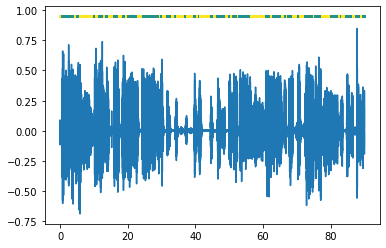

In [17]:
plot_diary(diary, signal, sample_rate)

In [18]:
Audio(FILENAME_MULTI)

In [19]:
def collect_speaker_signal(signal_batch, sample_rate, diary, spk_id):
    """ Collect the audio signal for a specific speaker """
    signal = signal_batch.reshape(
        signal_batch.shape[0] * signal_batch.shape[1])
    speaker_signal = [signal[int(segment[0]*sample_rate):int(segment[1]*sample_rate)]
                      for segment in diary if segment[2] == spk_id]

    return torch.cat(speaker_signal, 0)

In [20]:
def display_speaker_audio(diary, signal, sample_rate):
    """ Displays the audio signal as player for every speaker in diary """
    for spk_id in set([segment[2] for segment in diary]):
        speaker_signal = collect_speaker_signal(
            signal, sample_rate, diary, spk_id)
        display(Audio(speaker_signal, rate=sample_rate))

In [21]:
display_speaker_audio(diary, signal, sample_rate)

Without voice activation detection (VAD), the classifier seems to cluster non-speech vs. speech segments instead of diarizing the speakers. Thus, VAD might be necessary before diarization:

In [22]:
VAD = VAD.from_hparams(source="speechbrain/vad-crdnn-libriparty",
                       savedir="pretrained_models/vad-crdnn-libriparty",
                       overrides={"sample_rate": 48000, "n_fft": 1200})

In [23]:
def detect_voice_activation(filename, vad):
    """
    Extracts voice activation (speech) segments from an audio file using a neural VAD model:
    Computes posterior probability for speech segments from neural VAD model.
    Applies a threshold on the posterior probability to get candidate segments.
    Extracts speech segments using energy-based VAD.
    Merges segments that are close to each other.
    Removes short segments.
    Double check the energy-based VAD using the neural VAD model.
    """
    prob_chunks = vad.get_speech_prob_file(filename)
    prob_th = vad.apply_threshold(
        prob_chunks, activation_th=0.5, deactivation_th=0.25).float()
    boundaries = vad.get_boundaries(prob_th)
    boundaries_energy = vad.energy_VAD(
        filename, boundaries, activation_th=0.8, deactivation_th=0.0)
    boundaries_merged = vad.merge_close_segments(
        boundaries_energy, close_th=0.250)
    boundaries_short_removed = vad.remove_short_segments(
        boundaries_merged, len_th=0.250)
    boundaries_checked = vad.double_check_speech_segments(
        boundaries_short_removed, filename,  speech_th=0.5)

    return boundaries_checked

In [24]:
segments_vad = detect_voice_activation(FILENAME_MULTI, VAD)

In [25]:
def reshape_signal_batch_vad(signal_batch, sample_rate, segments_vad):
    """ 
    Reshapes the batches signal to segments that contain speech (VAD).
    Returns a list of torch.tensor()
    """
    signal = signal_batch.reshape(
        signal_batch.shape[0] * signal_batch.shape[1])
    segments_vad_frame = segments_vad*sample_rate
    signal_vad = [signal[int(segment[0]):int(segment[1])]
                  for segment in segments_vad_frame]

    return signal_vad

In [26]:
def generate_embeddings_batch_vad(encoder, signal_batch, sample_rate, segments_vad, filename):
    """ Generates embeddings and stores them for each VAD batch """
    signal_batch_vad = reshape_signal_batch_vad(
        signal_batch, sample_rate, segments_vad)
    embeddings_vad = torch.empty(len(signal_batch_vad), 1, 192)
    for i, batch in enumerate(signal_batch_vad):
        embeddings_vad[i, :] = encoder.encode_batch(batch)

    stat_obj = store_embeddings(embeddings_vad, segments_vad, filename)

    return embeddings_vad, segments_vad, stat_obj

In [27]:
embeddings_vad, _, stat_obj_vad = generate_embeddings_batch_vad(
    ecapa, signal, sample_rate, segments_vad, FILENAME_MULTI)

In [28]:
diarize_audio_batch(stat_obj_vad, FILENAME_MULTI.split("/")[-1], 0.05)

In [29]:
diary_vad = read_rttm(FILENAME_MULTI.split("/")[-1].split('.')[0] + ".rttm")

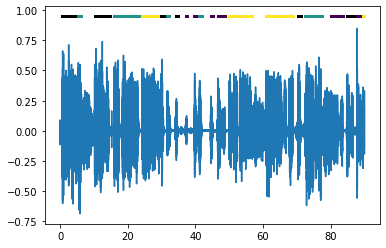

In [30]:
plot_diary(diary_vad, signal, sample_rate)

In [31]:
display_speaker_audio(diary_vad, signal, sample_rate)

After removing non-speech segments from the diarization, the clustering is still not able to separate the speakers correctly. It identifies more speakers than present in the data (5 vs. 3). What happens if the number of speakers is known in the clustering?

In [32]:
diarize_audio_batch(stat_obj_vad, FILENAME_MULTI.split("/")[-1], 0.05, K=3)

In [33]:
diary_vad_fixed = read_rttm(
    FILENAME_MULTI.split("/")[-1].split('.')[0] + ".rttm")

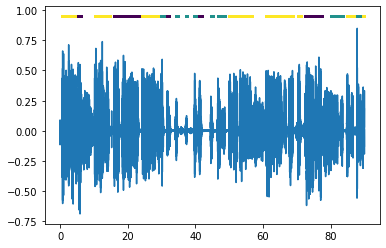

In [34]:
plot_diary(diary_vad_fixed, signal, sample_rate)

In [35]:
display_speaker_audio(diary_vad_fixed, signal, sample_rate)

With the number of speakers known the diarization seems to have improved slightly, but still makes quite a few mistakes.